In [1]:
from torchvision import transforms
from data import CustomDataset
from torch.utils.data import Dataset, DataLoader, RandomSampler, SequentialSampler
import torch 
from train import create_model
import matplotlib.pyplot as plt 
import matplotlib.patches as patches 
import numpy as np
from tqdm import tqdm 
import glob
from PIL import Image
import torchvision

In [2]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [3]:
class_names = ['background','Capacitor', 'Cylinder', 'Motor', 'Shock absorber', 'container']

In [4]:
label2idx = {label: idx for idx, label in enumerate(class_names)}
idx2label = {idx: label for idx, label in enumerate(class_names)}
idx2label

{0: 'background',
 1: 'Capacitor',
 2: 'Cylinder',
 3: 'Motor',
 4: 'Shock absorber',
 5: 'container'}

In [5]:
TEST_IMAGES = glob.glob("/home/shirshak/Thesis_Data/Photoscrap/*")

In [6]:
model = create_model(num_classes=6)
model.to(device)
checkpoint_path = "./recent_epoch_model.pth"
checkpoint = torch.load(checkpoint_path, weights_only=False)
model.load_state_dict(checkpoint['model_state_dict'])

<All keys matched successfully>

In [7]:
def visualize_predictions(image, boxes, labels, scores, threshold=0.5):
    """
    Visualize bounding boxes on image
    """
    # Convert tensor to PIL Image if needed
    if isinstance(image, torch.Tensor):
        if image.is_cuda:
            image = image.cpu()
        # Assuming image is in format [C, H, W]
        image = image.permute(1, 2, 0).numpy()
        if image.max() <= 1.0:
            image = (image * 255).astype(np.uint8)
    
    fig, ax = plt.subplots(1, 1, figsize=(12, 8))
    ax.imshow(image)
    
    # Filter predictions by confidence threshold
    valid_indices = scores >= threshold
    boxes = boxes[valid_indices]
    labels = labels[valid_indices]
    scores = scores[valid_indices]
    
    # Draw bounding boxes
    for box, label, score in zip(boxes, labels, scores):
        x1, y1, x2, y2 = box
        width = x2 - x1
        height = y2 - y1
        
        # Create rectangle patch
        rect = patches.Rectangle((x1, y1), width, height, 
                               linewidth=2, edgecolor='red', facecolor='none')
        ax.add_patch(rect)
        
        # Add label and score
        label_text = f'{class_names[label]}: {score:.2f}'
        ax.text(x1, y1-5, label_text, fontsize=10, color='red', 
                bbox=dict(boxstyle="round,pad=0.3", facecolor='white', alpha=0.7))
    
    ax.set_title(f'Predictions (threshold: {threshold})')
    ax.axis('off')
    plt.tight_layout()
    plt.show()

Testing:   0%|          | 1/294 [00:01<06:13,  1.27s/it]


Image 1:
Number of detections (confidence > 0.1): 0
No detections above threshold

Image 2:
Number of detections (confidence > 0.1): 3
Predictions:
  1. Class: Motor (ID: 3), Score: 0.657, Box: [466.1, 343.7, 534.3, 422.1]
  2. Class: Cylinder (ID: 2), Score: 0.549, Box: [44.3, 266.7, 117.2, 338.5]
  3. Class: Shock absorber (ID: 4), Score: 0.485, Box: [53.8, 271.9, 112.0, 332.3]


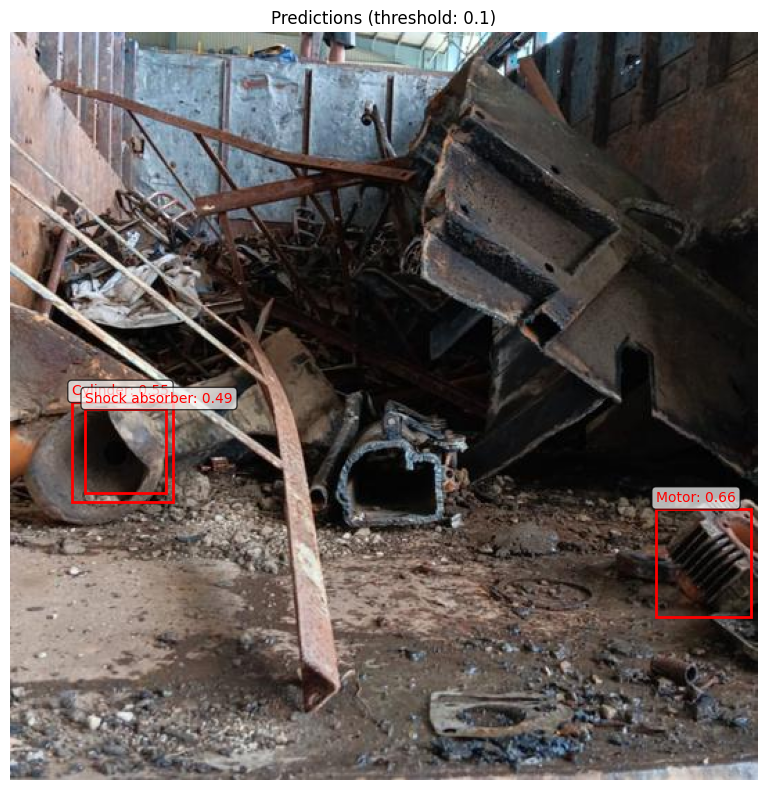

Testing:   1%|          | 2/294 [00:01<04:04,  1.20it/s]


Image 3:
Number of detections (confidence > 0.1): 1
Predictions:
  1. Class: Cylinder (ID: 2), Score: 0.175, Box: [120.2, 350.5, 334.3, 514.6]


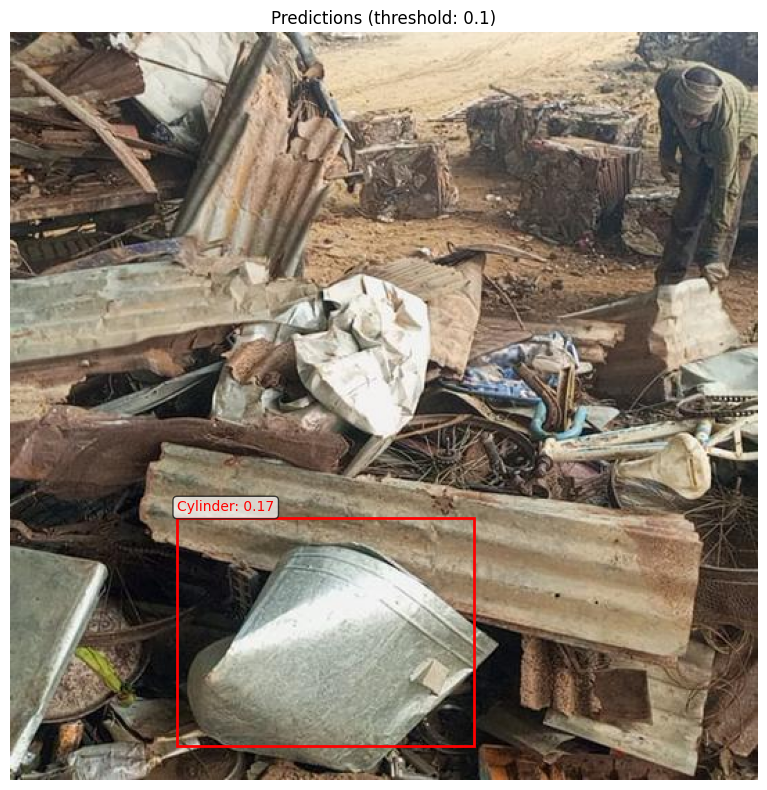

Testing:   1%|          | 3/294 [00:02<03:17,  1.47it/s]


Image 4:
Number of detections (confidence > 0.1): 3
Predictions:
  1. Class: Cylinder (ID: 2), Score: 0.175, Box: [108.6, 240.8, 468.8, 397.0]
  2. Class: Cylinder (ID: 2), Score: 0.116, Box: [424.5, 89.2, 540.0, 195.1]
  3. Class: container (ID: 5), Score: 0.101, Box: [430.9, 42.2, 539.2, 230.9]


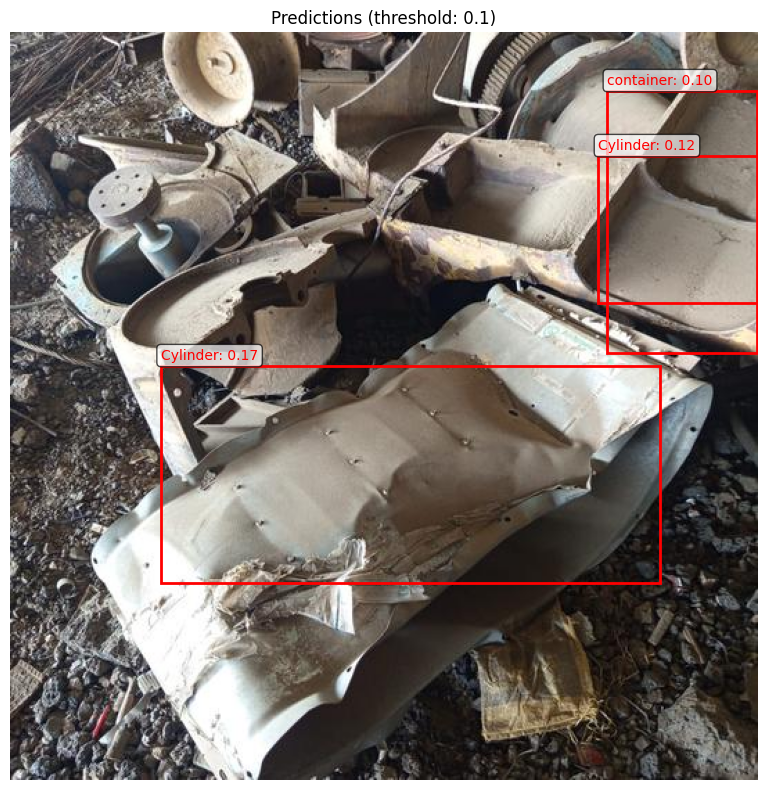

Testing:   1%|▏         | 4/294 [00:02<02:53,  1.67it/s]


Image 5:
Number of detections (confidence > 0.1): 0
No detections above threshold

Image 6:
Number of detections (confidence > 0.1): 1
Predictions:
  1. Class: Cylinder (ID: 2), Score: 0.570, Box: [264.5, 294.0, 301.4, 327.3]


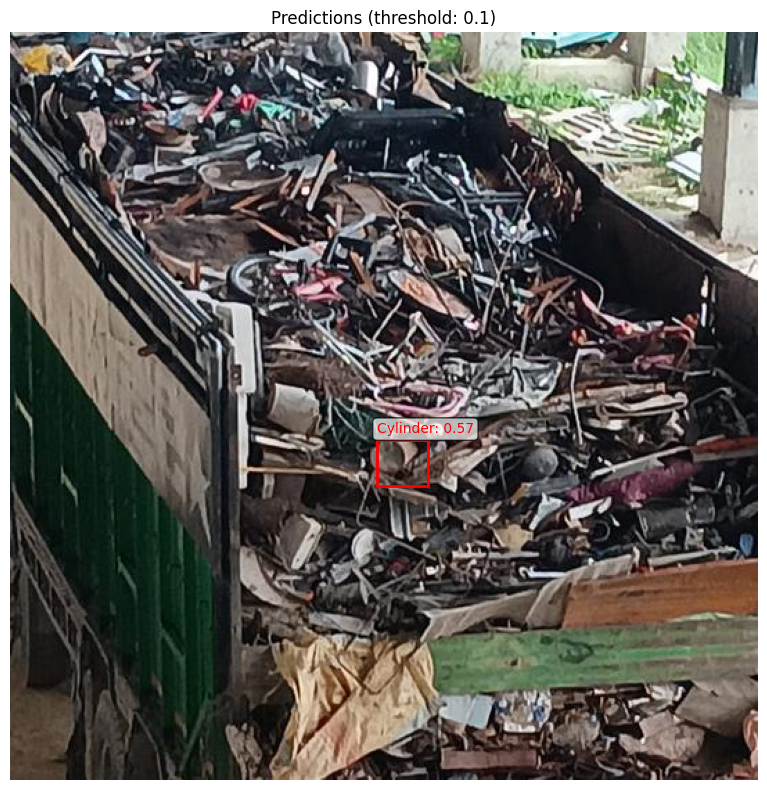

Testing:   2%|▏         | 6/294 [00:03<02:01,  2.38it/s]


Image 7:
Number of detections (confidence > 0.1): 0
No detections above threshold

Image 8:
Number of detections (confidence > 0.1): 2
Predictions:
  1. Class: container (ID: 5), Score: 0.121, Box: [29.8, 434.0, 154.9, 535.1]
  2. Class: Shock absorber (ID: 4), Score: 0.104, Box: [3.2, 182.5, 84.3, 262.4]


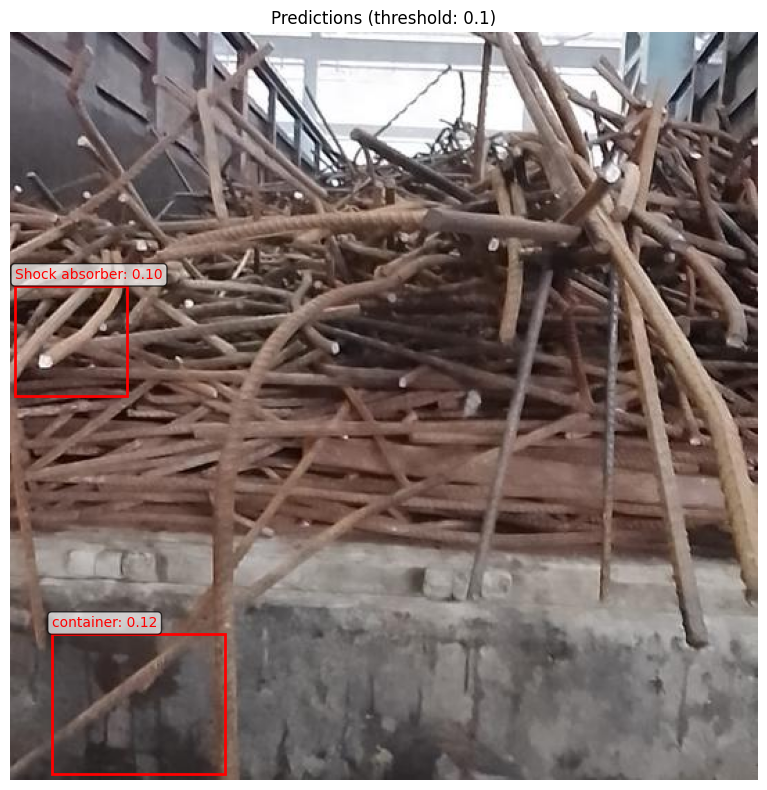

Testing:   3%|▎         | 8/294 [00:03<01:38,  2.91it/s]


Image 9:
Number of detections (confidence > 0.1): 3
Predictions:
  1. Class: Cylinder (ID: 2), Score: 0.251, Box: [302.5, 450.9, 382.1, 534.9]
  2. Class: Cylinder (ID: 2), Score: 0.176, Box: [269.3, 443.0, 408.7, 539.0]
  3. Class: Cylinder (ID: 2), Score: 0.104, Box: [325.4, 454.3, 362.7, 529.4]


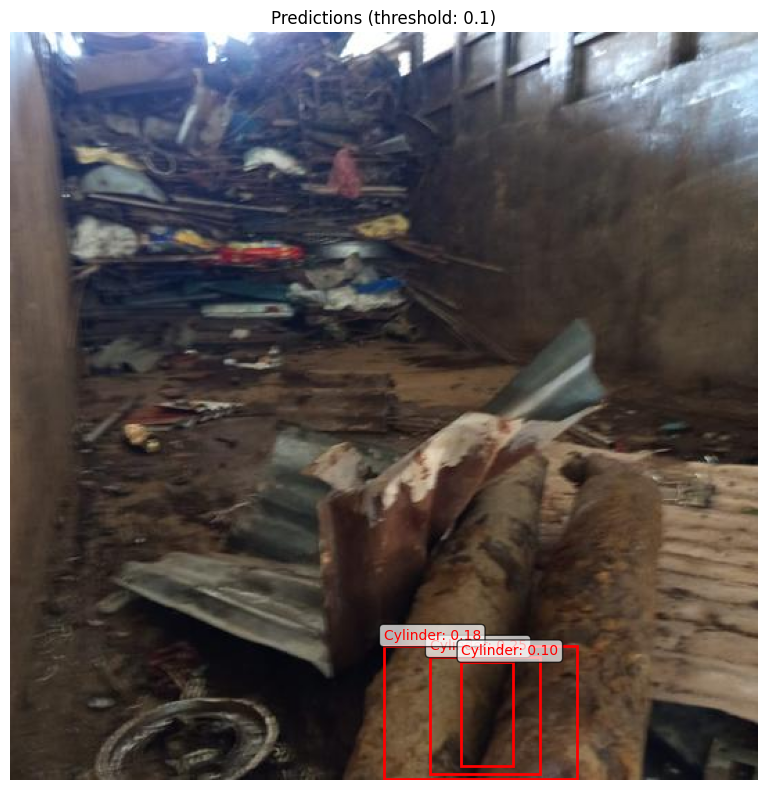

Testing:   3%|▎         | 9/294 [00:04<01:46,  2.67it/s]


Image 10:
Number of detections (confidence > 0.1): 0
No detections above threshold

Image 11:
Number of detections (confidence > 0.1): 2
Predictions:
  1. Class: Cylinder (ID: 2), Score: 0.177, Box: [448.1, 471.5, 499.3, 516.3]
  2. Class: Cylinder (ID: 2), Score: 0.116, Box: [192.4, 187.1, 230.5, 217.5]


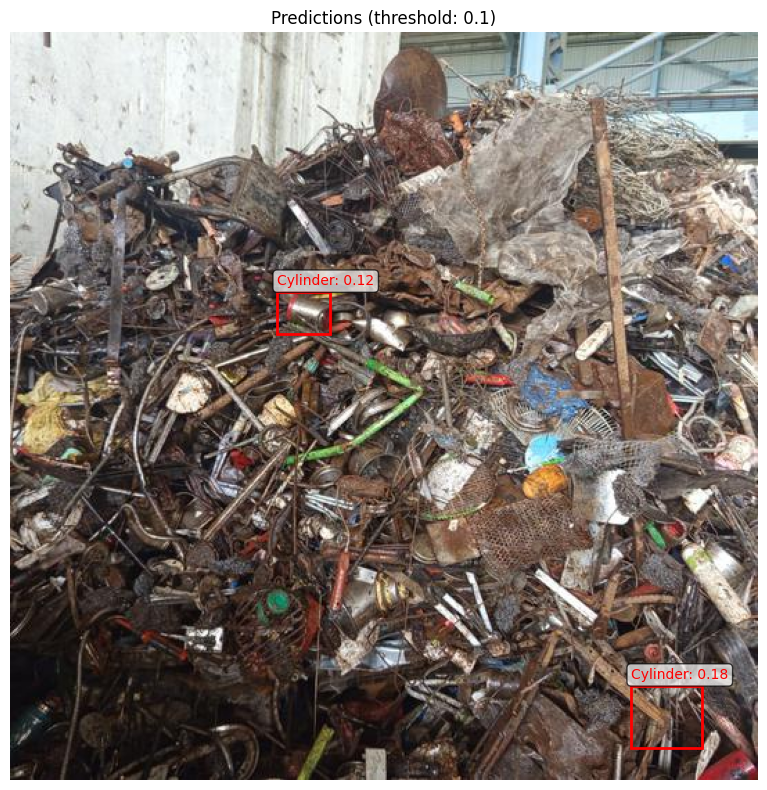

Testing:   4%|▎         | 11/294 [00:04<01:36,  2.92it/s]


Image 12:
Number of detections (confidence > 0.1): 2
Predictions:
  1. Class: Cylinder (ID: 2), Score: 0.128, Box: [105.0, 207.5, 254.5, 268.1]
  2. Class: container (ID: 5), Score: 0.106, Box: [313.7, 214.6, 507.1, 403.4]


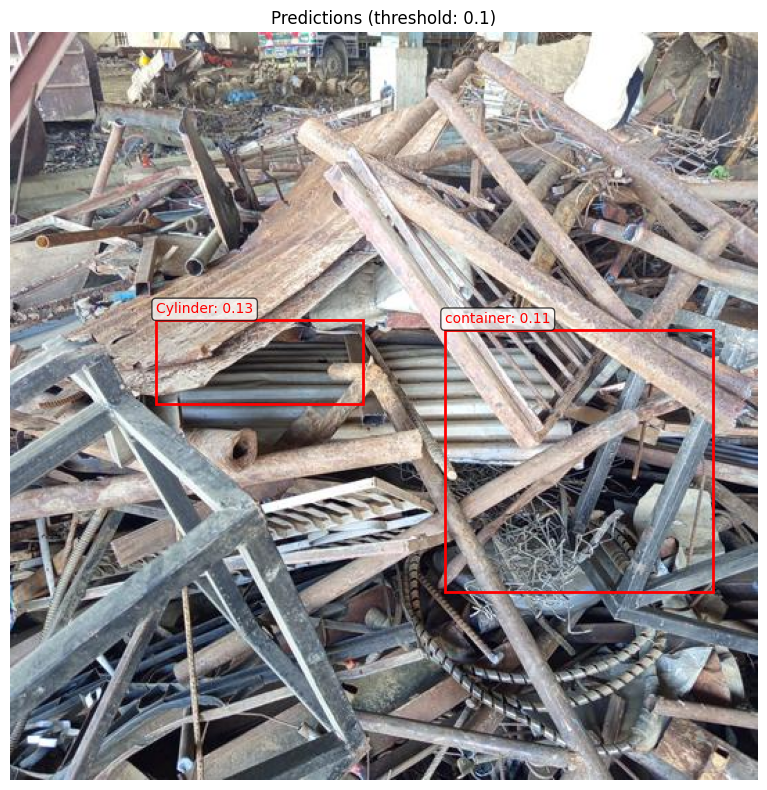

Testing:   4%|▍         | 12/294 [00:05<01:49,  2.58it/s]


Image 13:
Number of detections (confidence > 0.1): 0
No detections above threshold

Image 14:
Number of detections (confidence > 0.1): 0
No detections above threshold

Image 15:
Number of detections (confidence > 0.1): 4
Predictions:
  1. Class: Cylinder (ID: 2), Score: 0.393, Box: [261.1, 344.2, 326.3, 414.7]
  2. Class: Shock absorber (ID: 4), Score: 0.347, Box: [259.7, 346.5, 323.3, 417.0]
  3. Class: Cylinder (ID: 2), Score: 0.182, Box: [110.0, 306.1, 281.2, 466.8]
  4. Class: Cylinder (ID: 2), Score: 0.123, Box: [238.2, 56.9, 286.7, 121.1]


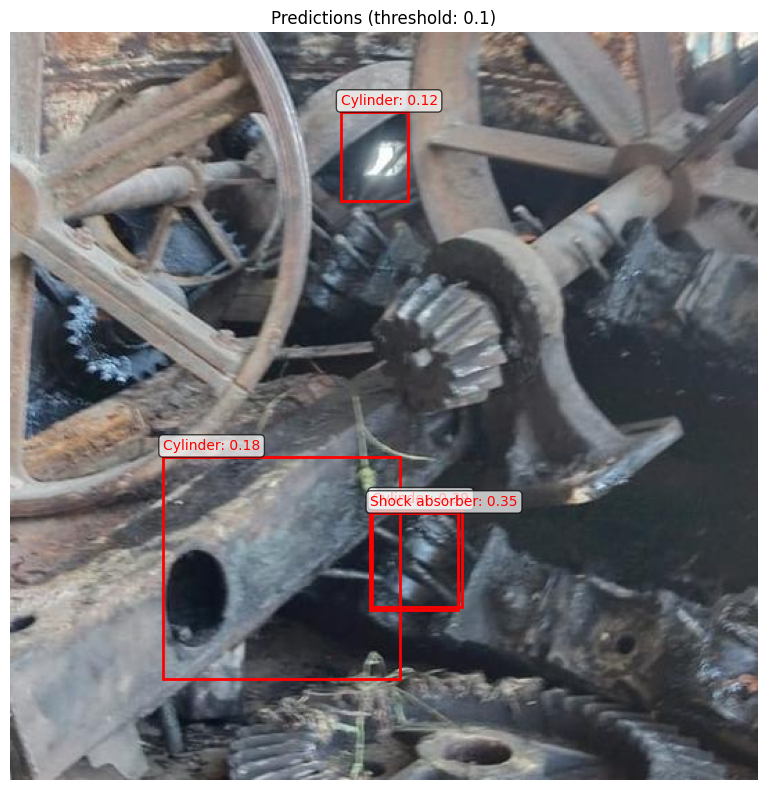

Testing:   5%|▌         | 15/294 [00:05<01:21,  3.42it/s]


Image 16:
Number of detections (confidence > 0.1): 1
Predictions:
  1. Class: Cylinder (ID: 2), Score: 0.339, Box: [10.7, 126.6, 309.8, 313.5]


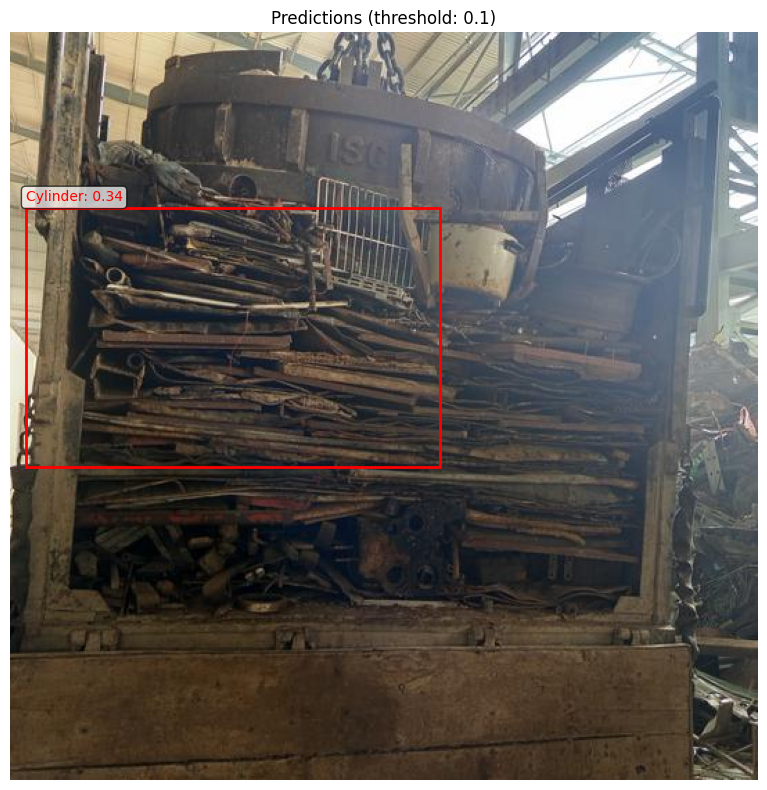

Testing:   5%|▌         | 16/294 [00:06<01:32,  3.02it/s]


Image 17:
Number of detections (confidence > 0.1): 2
Predictions:
  1. Class: Cylinder (ID: 2), Score: 0.403, Box: [167.4, 312.1, 281.4, 374.9]
  2. Class: Cylinder (ID: 2), Score: 0.135, Box: [1.6, 451.1, 63.8, 529.8]


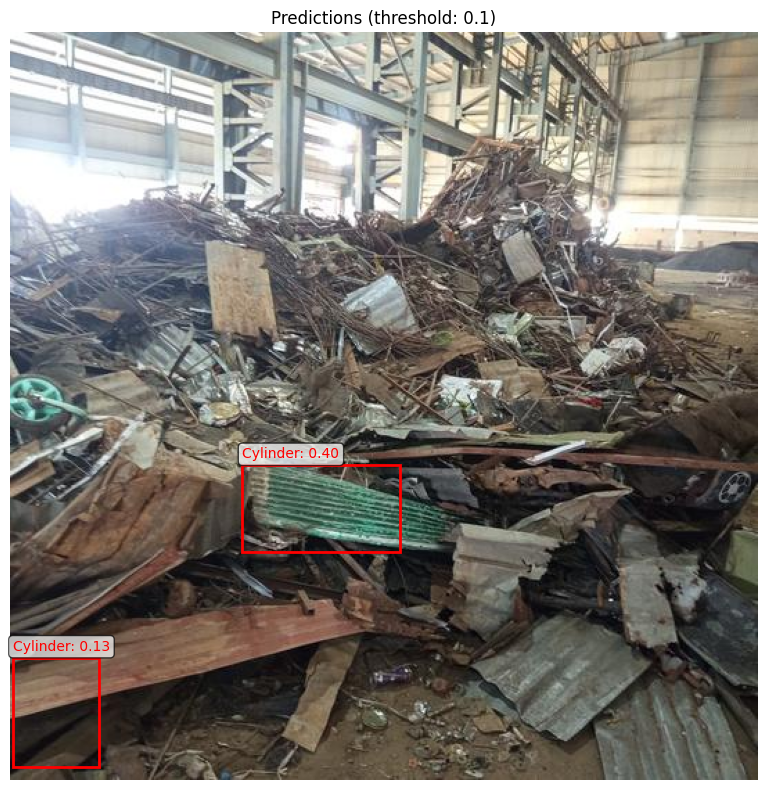

Testing:   6%|▌         | 17/294 [00:06<01:42,  2.70it/s]


Image 18:
Number of detections (confidence > 0.1): 0
No detections above threshold

Image 19:
Number of detections (confidence > 0.1): 0
No detections above threshold

Image 20:
Number of detections (confidence > 0.1): 3
Predictions:
  1. Class: Cylinder (ID: 2), Score: 0.987, Box: [70.7, 206.3, 120.9, 248.0]
  2. Class: Cylinder (ID: 2), Score: 0.630, Box: [285.4, 199.2, 329.3, 242.6]
  3. Class: Cylinder (ID: 2), Score: 0.147, Box: [47.3, 361.0, 134.3, 438.3]


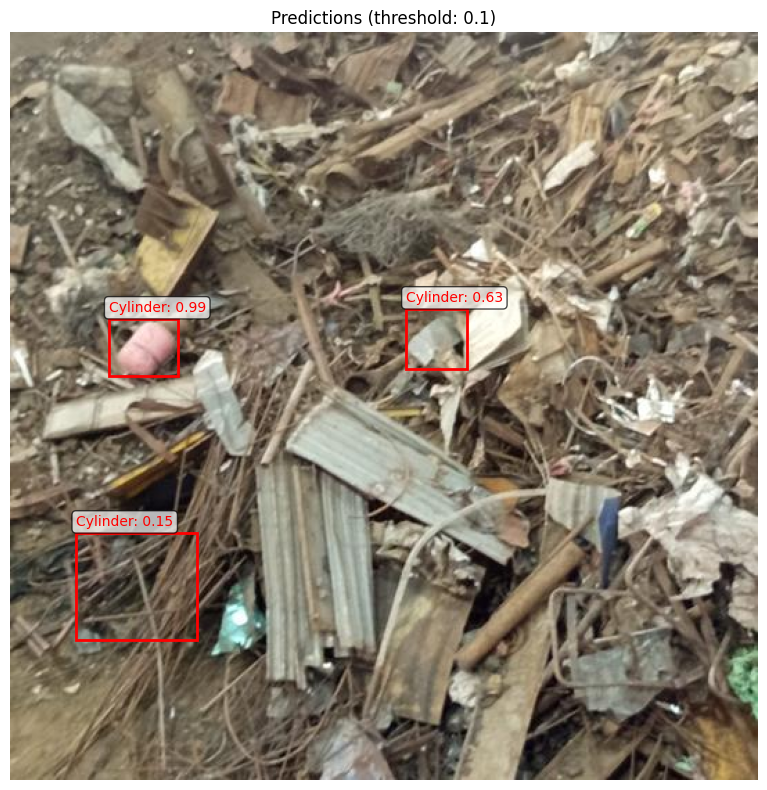

Testing:   7%|▋         | 20/294 [00:07<01:19,  3.47it/s]


Image 21:
Number of detections (confidence > 0.1): 3
Predictions:
  1. Class: Cylinder (ID: 2), Score: 0.216, Box: [307.8, 447.9, 454.6, 537.8]
  2. Class: Cylinder (ID: 2), Score: 0.116, Box: [333.4, 455.8, 414.9, 533.9]
  3. Class: Cylinder (ID: 2), Score: 0.102, Box: [300.3, 336.5, 427.8, 522.6]


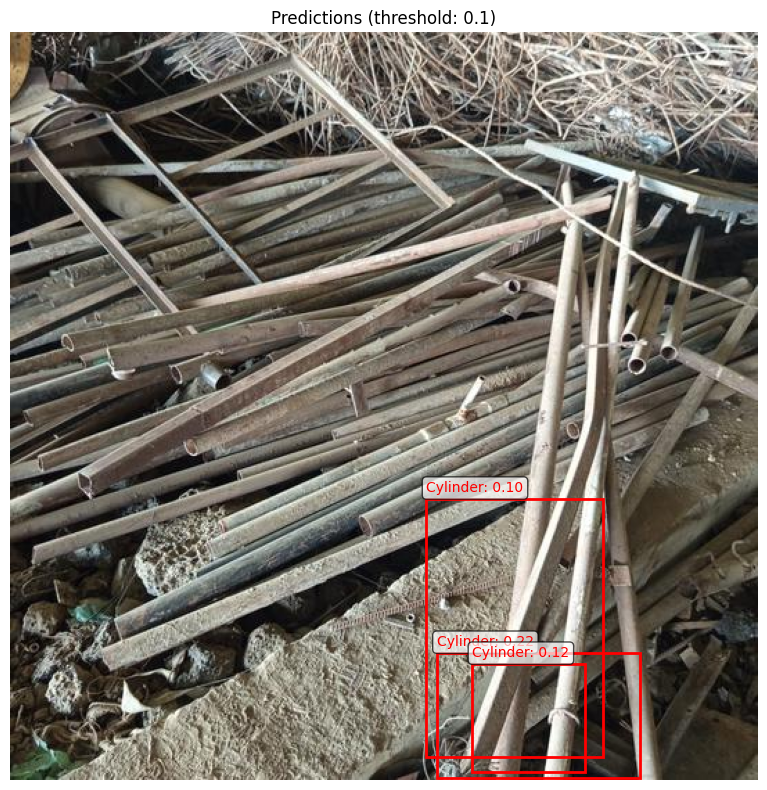

Testing:   7%|▋         | 21/294 [00:08<01:30,  3.01it/s]


Image 22:
Number of detections (confidence > 0.1): 2
Predictions:
  1. Class: Cylinder (ID: 2), Score: 0.365, Box: [192.6, 205.4, 237.0, 248.0]
  2. Class: container (ID: 5), Score: 0.119, Box: [39.1, 217.0, 178.2, 256.2]


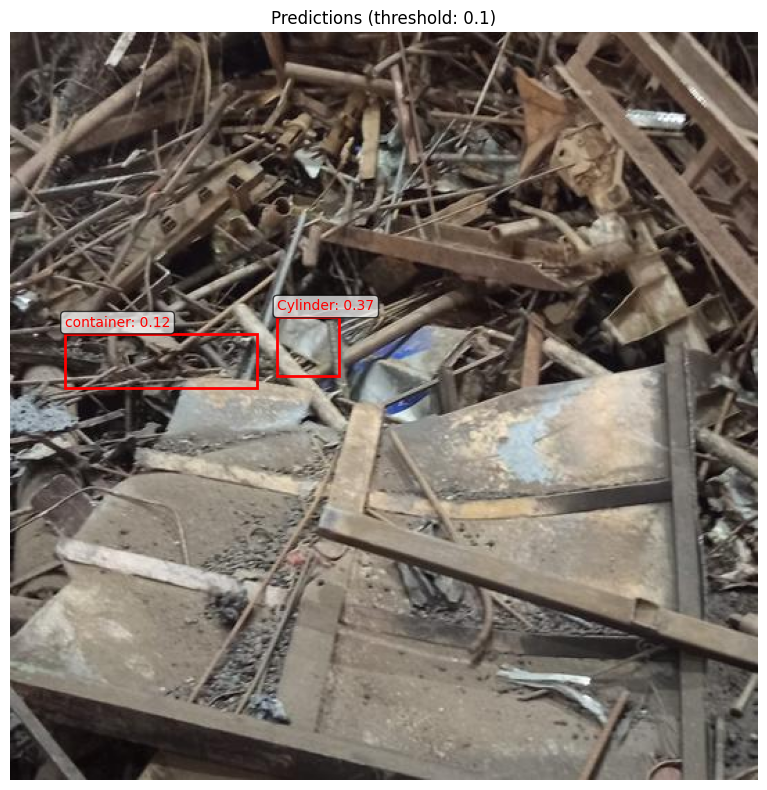

Testing:   7%|▋         | 22/294 [00:08<01:39,  2.74it/s]


Image 23:
Number of detections (confidence > 0.1): 0
No detections above threshold

Image 24:
Number of detections (confidence > 0.1): 0
No detections above threshold

Image 25:
Number of detections (confidence > 0.1): 4
Predictions:
  1. Class: Cylinder (ID: 2), Score: 0.949, Box: [79.9, 119.6, 146.9, 166.6]
  2. Class: Cylinder (ID: 2), Score: 0.174, Box: [189.0, 165.6, 257.2, 218.3]
  3. Class: Cylinder (ID: 2), Score: 0.165, Box: [89.6, 198.6, 186.7, 241.6]
  4. Class: Cylinder (ID: 2), Score: 0.124, Box: [105.0, 216.0, 151.3, 252.7]


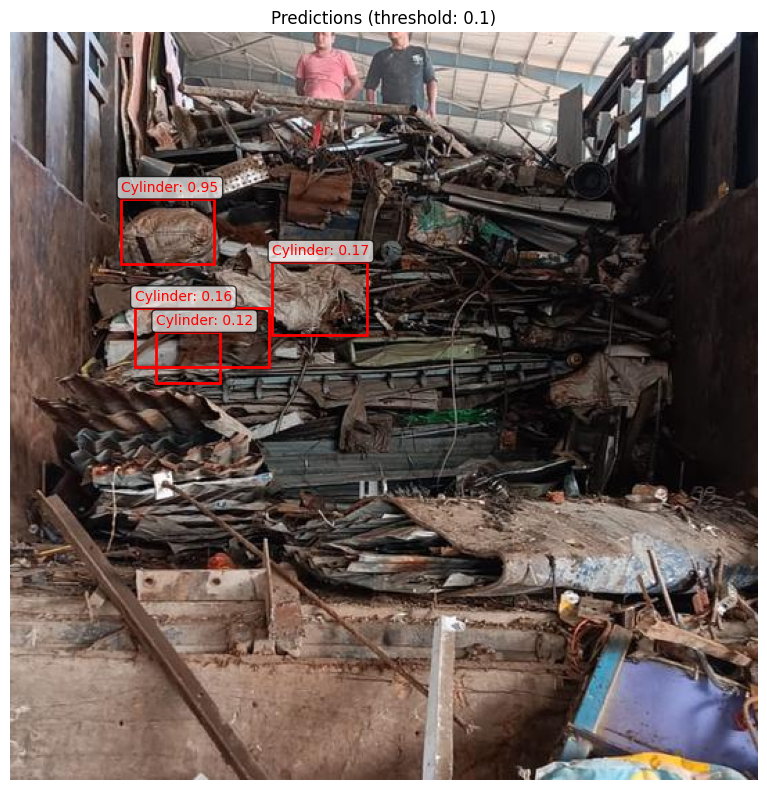

Testing:   9%|▊         | 25/294 [00:09<01:16,  3.50it/s]


Image 26:
Number of detections (confidence > 0.1): 3
Predictions:
  1. Class: Motor (ID: 3), Score: 0.343, Box: [82.9, 432.5, 158.4, 507.9]
  2. Class: Shock absorber (ID: 4), Score: 0.211, Box: [208.8, 331.4, 314.3, 419.6]
  3. Class: Motor (ID: 3), Score: 0.121, Box: [75.4, 453.7, 142.3, 528.2]


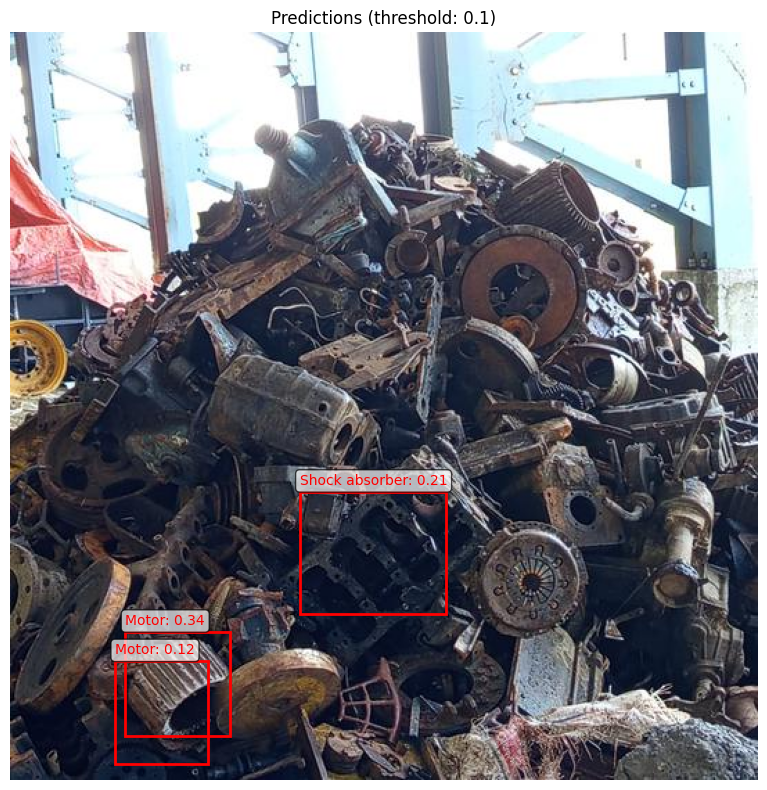

Testing:   9%|▉         | 26/294 [00:09<01:27,  3.07it/s]


Image 27:
Number of detections (confidence > 0.1): 0
No detections above threshold

Image 28:
Number of detections (confidence > 0.1): 3
Predictions:
  1. Class: Shock absorber (ID: 4), Score: 0.381, Box: [373.8, 273.3, 431.4, 316.6]
  2. Class: Motor (ID: 3), Score: 0.331, Box: [372.9, 269.6, 434.2, 317.7]
  3. Class: Shock absorber (ID: 4), Score: 0.256, Box: [64.5, 145.5, 165.9, 234.2]


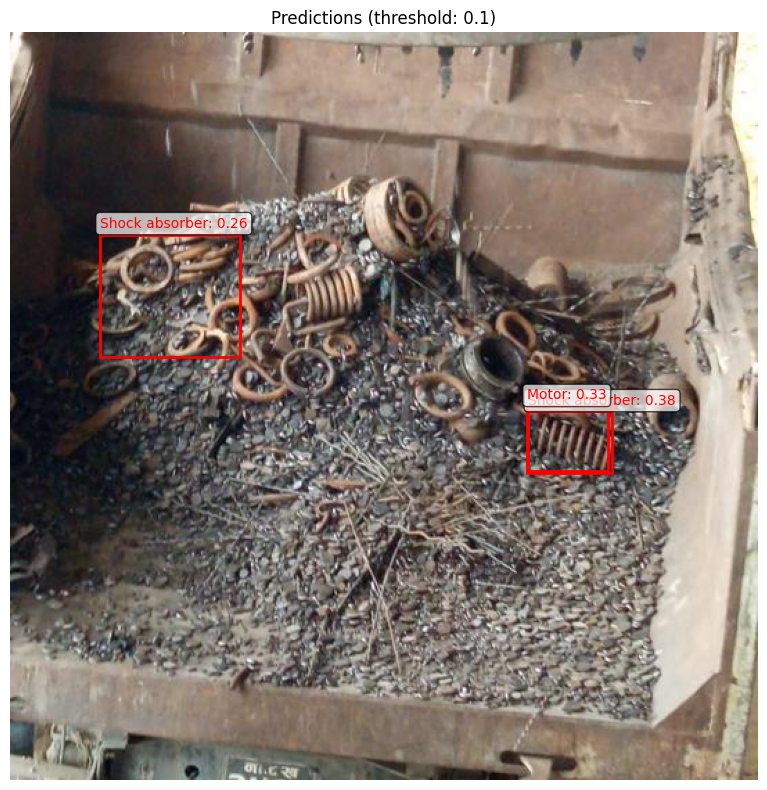

Testing:  10%|▉         | 28/294 [00:10<01:23,  3.20it/s]


Image 29:
Number of detections (confidence > 0.1): 0
No detections above threshold

Image 30:
Number of detections (confidence > 0.1): 4
Predictions:
  1. Class: Cylinder (ID: 2), Score: 0.706, Box: [259.2, 280.7, 390.3, 329.5]
  2. Class: Cylinder (ID: 2), Score: 0.645, Box: [2.5, 172.1, 110.2, 312.0]
  3. Class: container (ID: 5), Score: 0.174, Box: [327.7, 6.7, 411.0, 56.6]
  4. Class: container (ID: 5), Score: 0.138, Box: [251.7, 281.7, 395.7, 327.1]


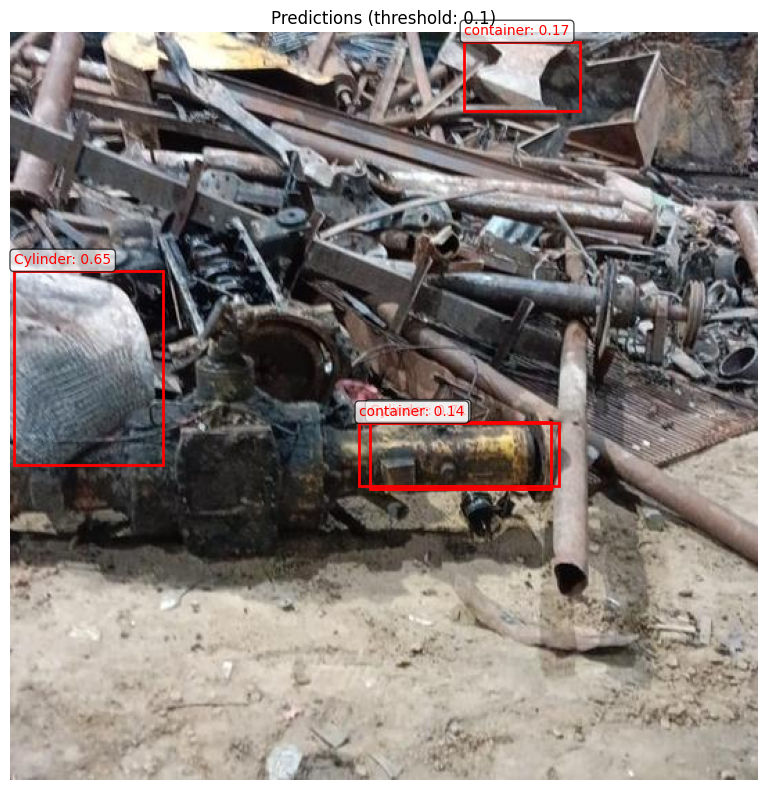

Testing:  10%|▉         | 29/294 [00:10<01:38,  2.68it/s]


In [8]:
model.eval()

num = 0
total_predictions = 0
confidence_threshold = 0.1

with torch.no_grad():
    for image_path in tqdm(TEST_IMAGES, desc="Testing"):

        image = Image.open(image_path)
        my_transforms = transforms.Compose([
            transforms.ToTensor(), 
            # transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
            ])

        image = my_transforms(image).unsqueeze(0)
        image = image.to(device)
        # print(image.shape) #torch.Size([1, 3, 540, 540])

        # Get predictions
        output = model(image)[0]
        
        # Process each image in the batch
        class_ids = output["labels"].cpu()
        boxes = output["boxes"].cpu()
        scores = output["scores"].cpu()
        
        # Filter by confidence threshold
        valid_mask = scores >= confidence_threshold
        filtered_boxes = boxes[valid_mask]
        filtered_labels = class_ids[valid_mask]
        filtered_scores = scores[valid_mask]
        
        total_predictions += len(filtered_labels)
        
        print(f"\nImage {num + 1}:")
        print(f"Number of detections (confidence > {confidence_threshold}): {len(filtered_labels)}")
        
        if len(filtered_labels) > 0:
            print("Predictions:")
            for j, (box, label, score) in enumerate(zip(filtered_boxes, filtered_labels, filtered_scores)):
                x1, y1, x2, y2 = box
                print(f"  {j+1}. Class: {class_names[label]} (ID: {label}), "
                        f"Score: {score:.3f}, Box: [{x1:.1f}, {y1:.1f}, {x2:.1f}, {y2:.1f}]")
            
            # Visualize first few images
            if num < 30:  # Show first 5 images

                # As we had unsqueezed the image to add batch, we again squeeze it to make 3 dimension
                visualize_predictions(image.squeeze(0), filtered_boxes, filtered_labels, filtered_scores, confidence_threshold)
        else:
            print("No detections above threshold")
        
        num += 1
        
        # Stop after testing a few images for demo
        if num >= 30:  # Test first 10 images
            break

In [9]:
torchvision.transforms.ToTensor()(Image.open(TEST_IMAGES[0])).shape

torch.Size([3, 540, 540])